# Room Upgrade Prediction With CatBoost

## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import shap

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, RocCurveDisplay, roc_auc_score, f1_score
from sklearn.base import BaseEstimator, TransformerMixin
from category_encoders import TargetEncoder
from catboost import CatBoostClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV

import sys
import os
sys.path.append(os.path.abspath(".."))
from common_functions import optimal_f1_search

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset Import

In [2]:
data = pd.read_parquet("../../data/hotel_booking_optimized.parquet")
data.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Ernest Barnes,Ernest.Barnes31@outlook.com,669-792-1661,************4322
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,Transient,0.0,0,0,Check-Out,2015-07-01,Andrea Baker,Andrea_Baker94@aol.com,858-637-6955,************9157
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Rebecca Parker,Rebecca_Parker@comcast.net,652-885-2745,************3734
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,Transient,75.0,0,0,Check-Out,2015-07-02,Laura Murray,Laura_M@gmail.com,364-656-8427,************5677
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,Transient,98.0,0,1,Check-Out,2015-07-03,Linda Hines,LHines@verizon.com,713-226-5883,************5498


## Exploring the Data

In [4]:
data["reserved_room_type"].unique(), data["assigned_room_type"].unique()

(['C', 'A', 'D', 'E', 'G', 'F', 'H', 'L', 'P', 'B']
 Categories (10, object): ['A', 'B', 'C', 'D', ..., 'G', 'H', 'L', 'P'],
 ['C', 'A', 'D', 'E', 'G', ..., 'B', 'H', 'P', 'L', 'K']
 Length: 12
 Categories (12, object): ['A', 'B', 'C', 'D', ..., 'I', 'K', 'L', 'P'])

In [5]:
data[data["reserved_room_type"].astype(str) != data["assigned_room_type"].astype(str)].shape

(14916, 36)

In [6]:
len(data) - len(data[data["reserved_room_type"].astype(str) != data["assigned_room_type"].astype(str)])

104473

In [7]:
len(data[data["reserved_room_type"].astype(str) != data["assigned_room_type"].astype(str)]) / len(data)

0.12493613314459456

## Preparing the Data

In [10]:
data["room_upgrade"] = np.where(
    data["reserved_room_type"].astype(str) != data["assigned_room_type"].astype(str), 1, 0
).astype(np.int8)

data["room_upgrade"].value_counts(normalize=True)

room_upgrade
0    0.875064
1    0.124936
Name: proportion, dtype: float64

In [13]:
class_weights = [1, 5]

In [14]:
# A function to map week number to season
def week_to_season(week):
    if 10 <= week <= 21:
        return 'Spring'
    elif 22 <= week <= 34:
        return 'Summer'
    elif 35 <= week <= 47:
        return 'Fall'
    else:
        return 'Winter'

data["total_stay"] = data["stays_in_weekend_nights"] + data["stays_in_week_nights"]
data["adr_per_person"] = data["adr"] / (data["adults"] + data["children"] + data["babies"])
data["arrival_season"] = data["arrival_date_week_number"].apply(week_to_season)

In [15]:
# Columns for one-hot encoding (low-cardinality categorical)
onehot_cols = [
    "hotel", "meal", "market_segment", "distribution_channel",
    "customer_type", "deposit_type", "arrival_date_month", "arrival_season"
]

# Columns for target encoding (high-cardinality categorical)
target_cols = ["country"]

# Numeric / passthrough columns
numeric_cols = [
    "lead_time", "arrival_date_year", "arrival_date_week_number",
    "arrival_date_day_of_month", "stays_in_weekend_nights", "stays_in_week_nights",
    "adults", "children", "babies", "previous_cancellations",
    "previous_bookings_not_canceled",
    "adr", "total_of_special_requests",
    "is_repeated_guest", "total_stay", "adr_per_person"
]

# Unincluded columns will be dropped in the preprocessing step

In [16]:
# Target encoding for high-cardinality categorical features
target_encoder = TargetEncoder(cols=target_cols, smoothing=5)  # CV-safe inside pipeline

# ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("target", target_encoder, target_cols),
        ("onehot", OneHotEncoder(handle_unknown="ignore"), onehot_cols),
        ("numeric", "passthrough", numeric_cols)
    ]
)

## Train/Test Split

In [17]:
X = data.drop("room_upgrade", axis=1)
y = data["room_upgrade"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

## First Model

### Pipeline

In [18]:
pipeline_1 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights # handling class imbalance
    ))
])

In [19]:
param_distributions_1 = {
    'model__depth': [4, 6, 8, 10],
    'model__learning_rate': [0.01, 0.03, 0.05, 0.1],
    'model__l2_leaf_reg': [1, 3, 5, 7, 9],
    'model__bagging_temperature': [0, 1, 2, 5],
    'model__border_count': [32, 64, 128, 254],
    'model__min_data_in_leaf': [1, 5, 10, 20],
    'model__colsample_bylevel': [0.6, 0.8, 1.0]
}

In [20]:
random_search_1 = RandomizedSearchCV(
    pipeline_1,
    param_distributions=param_distributions_1,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

### Search

In [21]:
random_search_1.fit(X_train, y_train)

cat_boost_pipeline_1 = random_search_1.best_estimator_
cat_boost_pipeline_1

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
[CV 2/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.4s
[CV 3/3] END model__bagging_temperature=1, model__border_count=254, model__colsample_bylevel=0.8, model__depth=8, model__l2_leaf_reg=9, model__learning_rate=0.03, model__min_data_in_leaf=10;, score=nan total time=   0.5s
0:	learn: 0.6575978	total: 1.92s	remaining: 1h 20m 9s
1:	learn: 0.6330961	total: 1.93s	remaining: 40m 12s
2:	learn: 0.6150995	total: 1.94s	remaining: 26m 52s
3:	learn: 0.5998178	total: 1.94s	remaining: 20m 13s
4:	learn: 0.5866242	total: 1.95s	remaining: 16m 13s
5:	learn: 0.5

c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py:516: FitFailedWarning: 
99 fits failed out of a total of 150.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
99 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\model_selection\_validation.py", line 859, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Sebastijan\anaconda3\envs\hotel_management\Lib\site-packages\sklearn\base.py", line 1365, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Sebastijan\anaconda3

0:	learn: 0.6807927	total: 21.5ms	remaining: 53.7s
1:	learn: 0.6694234	total: 34.6ms	remaining: 43.2s
2:	learn: 0.6589155	total: 47.8ms	remaining: 39.8s
3:	learn: 0.6494109	total: 61.1ms	remaining: 38.1s
4:	learn: 0.6405050	total: 74.6ms	remaining: 37.2s
5:	learn: 0.6321881	total: 87.9ms	remaining: 36.6s
6:	learn: 0.6249287	total: 101ms	remaining: 35.9s
7:	learn: 0.6187237	total: 114ms	remaining: 35.5s
8:	learn: 0.6124697	total: 127ms	remaining: 35.2s
9:	learn: 0.6062586	total: 141ms	remaining: 35.1s
10:	learn: 0.6008234	total: 154ms	remaining: 34.8s
11:	learn: 0.5958653	total: 168ms	remaining: 34.9s
12:	learn: 0.5913026	total: 182ms	remaining: 34.9s
13:	learn: 0.5867412	total: 197ms	remaining: 34.9s
14:	learn: 0.5830650	total: 210ms	remaining: 34.8s
15:	learn: 0.5786095	total: 222ms	remaining: 34.5s
16:	learn: 0.5746872	total: 235ms	remaining: 34.4s
17:	learn: 0.5710220	total: 249ms	remaining: 34.4s
18:	learn: 0.5675207	total: 264ms	remaining: 34.4s
19:	learn: 0.5647365	total: 282ms	r

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [22]:
random_search_1.best_params_

{'model__min_data_in_leaf': 10,
 'model__learning_rate': 0.03,
 'model__l2_leaf_reg': 7,
 'model__depth': 10,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 64,
 'model__bagging_temperature': 1}

In [23]:
y_pred_train_1 = cat_boost_pipeline_1.predict(X_train)
y_pred_test_1 = cat_boost_pipeline_1.predict(X_test)

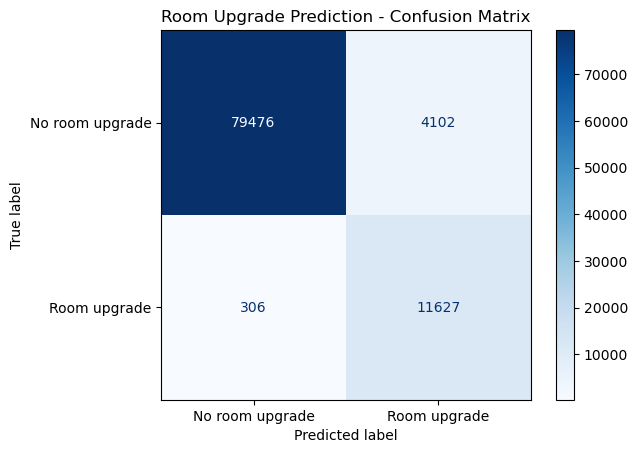

                 precision    recall  f1-score   support

No room upgrade       1.00      0.95      0.97     83578
   Room upgrade       0.74      0.97      0.84     11933

       accuracy                           0.95     95511
      macro avg       0.87      0.96      0.91     95511
   weighted avg       0.96      0.95      0.96     95511



In [24]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_1,
    display_labels=["No room upgrade", "Room upgrade"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Room Upgrade Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_1, target_names=["No room upgrade", "Room upgrade"]))

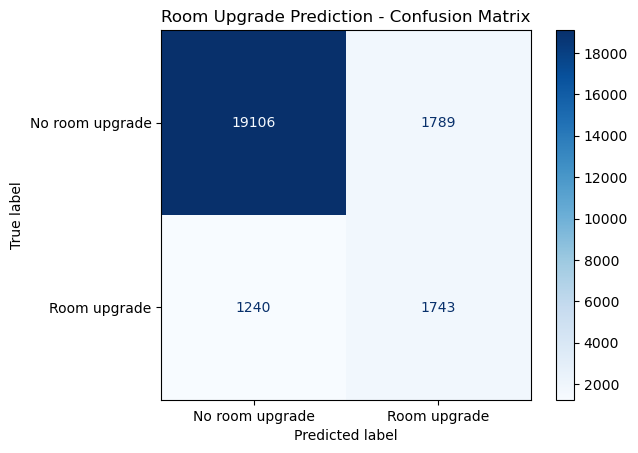

                 precision    recall  f1-score   support

No room upgrade       0.94      0.91      0.93     20895
   Room upgrade       0.49      0.58      0.54      2983

       accuracy                           0.87     23878
      macro avg       0.72      0.75      0.73     23878
   weighted avg       0.88      0.87      0.88     23878



In [25]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_1,
    display_labels=["No room upgrade", "Room upgrade"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Room Upgrade Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_1, target_names=["No room upgrade", "Room upgrade"]))

ROC-AUC: 0.8621664666419113


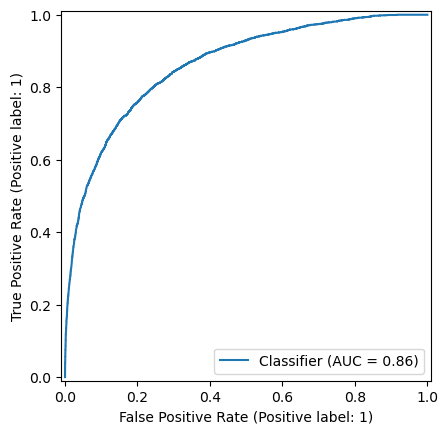

In [26]:
y_probs_1 = cat_boost_pipeline_1.predict_proba(X_test)[:,1]
auc_1 = roc_auc_score(y_test, y_probs_1)
print("ROC-AUC:", auc_1)

RocCurveDisplay.from_predictions(y_test, y_probs_1)
plt.show();

Best threshold: 0.59
Best F1: 0.5394850527043373


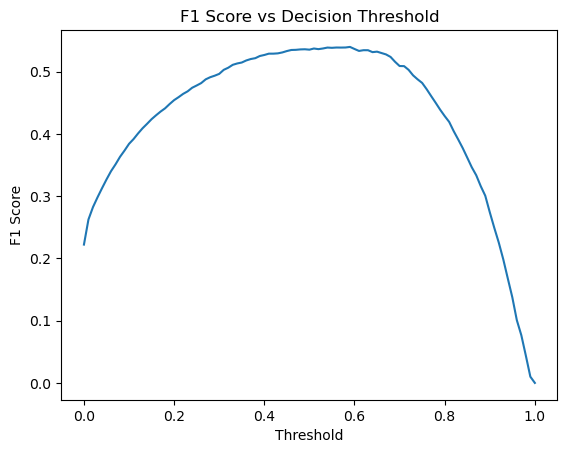

In [27]:
optimal_f1_search(y_test, y_probs_1)

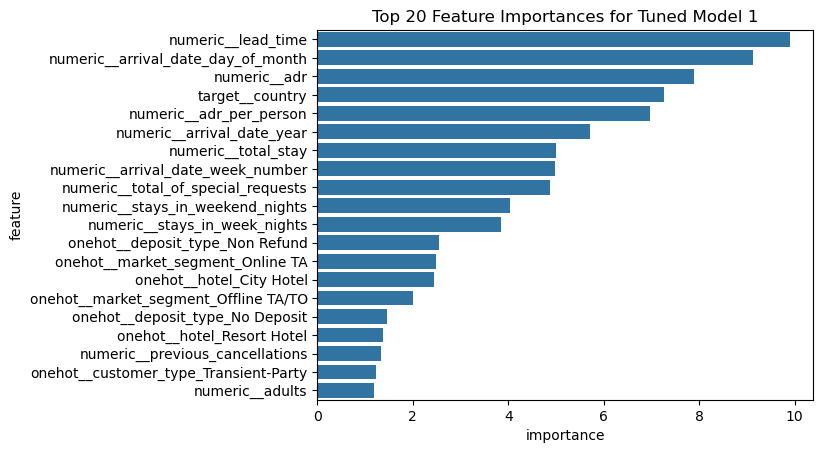

In [28]:
feature_names_1 = cat_boost_pipeline_1.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_1 = cat_boost_pipeline_1.named_steps['model']
importances_1 = tuned_cat_boost_model_1.feature_importances_

df_imp_1 = pd.DataFrame({
    'feature': feature_names_1,
    'importance': importances_1
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_1)
plt.title("Top 20 Feature Importances for Tuned Model 1")
plt.show();

## Second Model

### Pipeline

In [30]:
class_weights_2 = [1, 3.5] # lower weight for positive class to fix some recall issues

pipeline_2 = Pipeline([
    # preprocessing step
    ("preprocessing", preprocessor),

    # model step
    ("model", CatBoostClassifier(
        # Basic hyperparameters
        iterations=2500,      # number of boosting rounds
        task_type='GPU',      # enable GPU
        devices='0',          # GPU device
        verbose=1,           # print progress every iteration
        early_stopping_rounds=100,  # stop if no improvement for 100 rounds
        random_state=42,
        class_weights=class_weights_2 # handling class imbalance
    ))
])

In [31]:
param_distributions_2 = {
    'model__depth': [9, 10], # higher than 10 would likely lead to overfitting
    'model__learning_rate': [0.02, 0.03, 0.04],
    'model__l2_leaf_reg': [6, 7, 8],
    'model__bagging_temperature': [1],
    'model__border_count': [64],
    'model__min_data_in_leaf': [8, 10, 12, 14],
    'model__colsample_bylevel': [1.0]
}

In [32]:
random_search_2 = RandomizedSearchCV(
    pipeline_2,
    param_distributions=param_distributions_2,
    n_iter=50, # Number of random combinations to try
    cv=3,
    scoring="roc_auc",
    verbose=3,
    n_jobs=1, # Use 1 to avoid potential GPU conflicts
    random_state=42
)

### Search

In [33]:
random_search_2.fit(X_train, y_train)

cat_boost_pipeline_2 = random_search_2.best_estimator_
cat_boost_pipeline_2

Fitting 3 folds for each of 50 candidates, totalling 150 fits
0:	learn: 0.6783063	total: 14.6ms	remaining: 36.4s
1:	learn: 0.6647844	total: 28.1ms	remaining: 35.1s
2:	learn: 0.6529989	total: 41.5ms	remaining: 34.5s
3:	learn: 0.6417296	total: 54.7ms	remaining: 34.1s
4:	learn: 0.6314316	total: 64.2ms	remaining: 32.1s
5:	learn: 0.6222182	total: 73ms	remaining: 30.3s
6:	learn: 0.6139884	total: 81.5ms	remaining: 29s
7:	learn: 0.6069476	total: 90.6ms	remaining: 28.2s
8:	learn: 0.6005431	total: 99.7ms	remaining: 27.6s
9:	learn: 0.5938715	total: 108ms	remaining: 27s
10:	learn: 0.5884178	total: 117ms	remaining: 26.5s
11:	learn: 0.5833003	total: 126ms	remaining: 26.1s
12:	learn: 0.5781884	total: 134ms	remaining: 25.7s
13:	learn: 0.5732475	total: 143ms	remaining: 25.4s
14:	learn: 0.5680990	total: 152ms	remaining: 25.2s
15:	learn: 0.5637724	total: 161ms	remaining: 25s
16:	learn: 0.5597968	total: 170ms	remaining: 24.8s
17:	learn: 0.5561469	total: 179ms	remaining: 24.6s
18:	learn: 0.5526608	total: 1

,steps,"[('preprocessing', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


### Evaluation

In [34]:
random_search_2.best_params_

{'model__min_data_in_leaf': 14,
 'model__learning_rate': 0.02,
 'model__l2_leaf_reg': 8,
 'model__depth': 9,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 64,
 'model__bagging_temperature': 1}

In [35]:
y_pred_train_2 = cat_boost_pipeline_2.predict(X_train)
y_pred_test_2 = cat_boost_pipeline_2.predict(X_test)

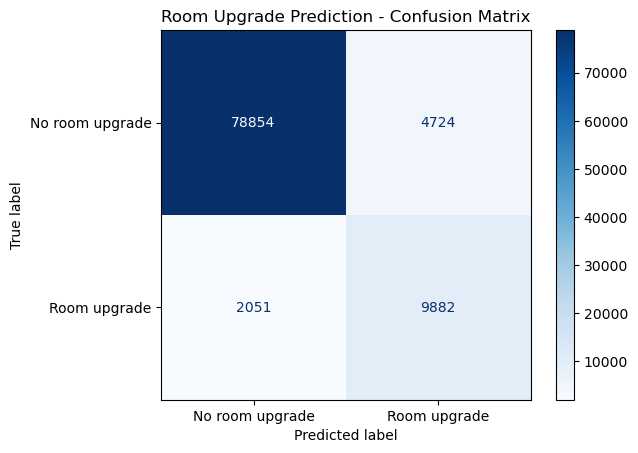

                 precision    recall  f1-score   support

No room upgrade       0.97      0.94      0.96     83578
   Room upgrade       0.68      0.83      0.74     11933

       accuracy                           0.93     95511
      macro avg       0.83      0.89      0.85     95511
   weighted avg       0.94      0.93      0.93     95511



In [36]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_train, y_pred_train_2,
    display_labels=["No room upgrade", "Room upgrade"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Room Upgrade Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_train, y_pred_train_2, target_names=["No room upgrade", "Room upgrade"]))

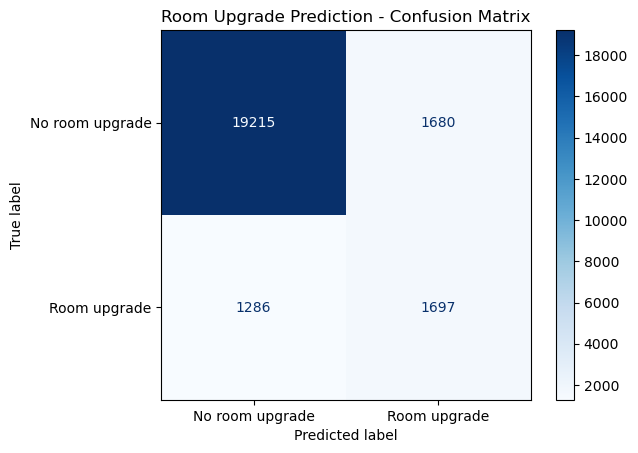

                 precision    recall  f1-score   support

No room upgrade       0.94      0.92      0.93     20895
   Room upgrade       0.50      0.57      0.53      2983

       accuracy                           0.88     23878
      macro avg       0.72      0.74      0.73     23878
   weighted avg       0.88      0.88      0.88     23878



In [37]:
disp = ConfusionMatrixDisplay.from_predictions(
    y_test, y_pred_test_2,
    display_labels=["No room upgrade", "Room upgrade"],
    cmap="Blues",
    normalize=None
)
disp.ax_.set_title("Room Upgrade Prediction - Confusion Matrix")
plt.show();

print(classification_report(y_test, y_pred_test_2, target_names=["No room upgrade", "Room upgrade"]))

ROC-AUC: 0.8637649640537024


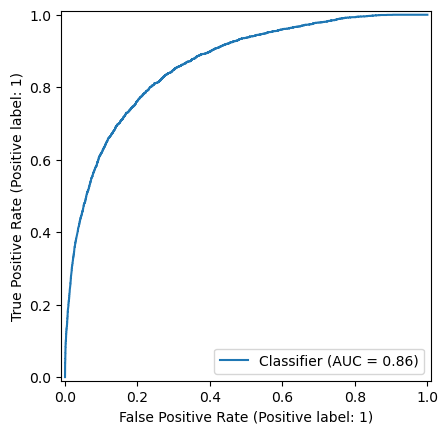

In [38]:
y_probs_2 = cat_boost_pipeline_2.predict_proba(X_test)[:,1]
auc_2 = roc_auc_score(y_test, y_probs_2)
print("ROC-AUC:", auc_2)

RocCurveDisplay.from_predictions(y_test, y_probs_2)
plt.show();

Best threshold: 0.46
Best F1: 0.5348393721578407


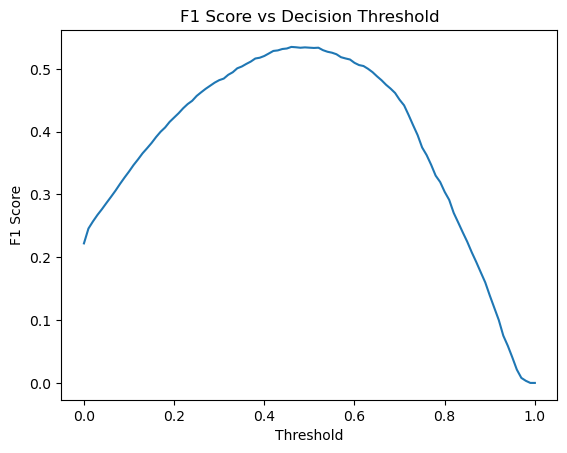

In [39]:
optimal_f1_search(y_test, y_probs_2)

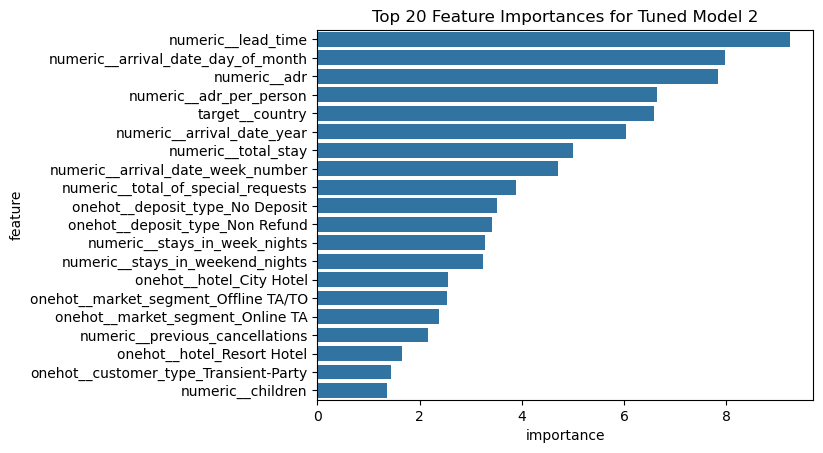

In [40]:
feature_names_2 = cat_boost_pipeline_2.named_steps["preprocessing"].get_feature_names_out()
tuned_cat_boost_model_2 = cat_boost_pipeline_2.named_steps['model']
importances_2 = tuned_cat_boost_model_2.feature_importances_

df_imp_2 = pd.DataFrame({
    'feature': feature_names_2,
    'importance': importances_2
}).sort_values(by='importance', ascending=False).head(20)

sns.barplot(x='importance', y='feature', data=df_imp_2)
plt.title("Top 20 Feature Importances for Tuned Model 2")
plt.show();

## Saving the best model, f1 threshold, feature importancesm and mean shap values

### Save model

In [41]:
# Custom transformer for engineered features
class FeatureEngineer(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self
    
    # A function to map week number to season
    def week_to_season(self, week):
        if 10 <= week <= 21:
            return 'Spring'
        elif 22 <= week <= 34:
            return 'Summer'
        elif 35 <= week <= 47:
            return 'Fall'
        else:
            return 'Winter'

    def transform(self, X):
        X = X.copy()
        # total_stay
        X['total_stay'] = X['stays_in_weekend_nights'] + X['stays_in_week_nights']
        # adr_per_person
        X['adr_per_person'] = X['adr'] / (X['adults'] + X['children'] + X['babies']).replace(0, 1)
        # arrival_season
        X['arrival_season'] = X['arrival_date_week_number'].apply(self.week_to_season)
        return X
    
    created_columns = ['total_stay', 'adr_per_person', 'arrival_season']

In [42]:
ALL_REQUIRED_COLUMNS = onehot_cols + target_cols + numeric_cols

ALL_REQUIRED_COLUMNS = [c for c in ALL_REQUIRED_COLUMNS if c not in FeatureEngineer.created_columns]

In [43]:
best_params = {'model__min_data_in_leaf': 14,
 'model__learning_rate': 0.02,
 'model__l2_leaf_reg': 8,
 'model__depth': 9,
 'model__colsample_bylevel': 1.0,
 'model__border_count': 64,
 'model__bagging_temperature': 1}

In [44]:
class SchemaValidator(BaseEstimator, TransformerMixin):
    def __init__(self, required_columns):
        self.required_columns = required_columns

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        missing = [c for c in self.required_columns if c not in X.columns]
        if missing:
            raise ValueError(
                f"Model input schema violation. Missing columns: {missing}"
            )
        return X

In [45]:
pipeline_final = Pipeline([
    ("schema_validator", SchemaValidator(ALL_REQUIRED_COLUMNS)),
    ("feature_engineering", FeatureEngineer()),
    ("preprocessing", preprocessor),
    ("model", CatBoostClassifier(
        iterations=2500,
        task_type='CPU', # use CPU for final model
        # devices='0', # not needed for CPU
        verbose=1,
        early_stopping_rounds=100,
        random_state=42,
        class_weights=class_weights_2,
        **{key.replace('model__', ''): value for key, value in best_params.items() if key.startswith('model__')}
    ))
])

In [46]:
pipeline_final.fit(X_train, y_train)

0:	learn: 0.6836896	total: 14ms	remaining: 35s
1:	learn: 0.6746540	total: 26.4ms	remaining: 32.9s
2:	learn: 0.6667087	total: 39.5ms	remaining: 32.9s
3:	learn: 0.6587998	total: 53ms	remaining: 33s
4:	learn: 0.6512056	total: 68ms	remaining: 33.9s
5:	learn: 0.6441193	total: 81.7ms	remaining: 34s
6:	learn: 0.6377244	total: 94.7ms	remaining: 33.7s
7:	learn: 0.6325333	total: 108ms	remaining: 33.7s
8:	learn: 0.6263065	total: 121ms	remaining: 33.6s
9:	learn: 0.6205740	total: 134ms	remaining: 33.4s
10:	learn: 0.6155378	total: 147ms	remaining: 33.2s
11:	learn: 0.6111223	total: 160ms	remaining: 33.2s
12:	learn: 0.6057618	total: 173ms	remaining: 33.1s
13:	learn: 0.6020892	total: 185ms	remaining: 32.9s
14:	learn: 0.5973431	total: 197ms	remaining: 32.7s
15:	learn: 0.5938648	total: 210ms	remaining: 32.6s
16:	learn: 0.5908824	total: 222ms	remaining: 32.5s
17:	learn: 0.5872953	total: 235ms	remaining: 32.5s
18:	learn: 0.5840513	total: 249ms	remaining: 32.6s
19:	learn: 0.5809640	total: 264ms	remaining: 3

,steps,"[('schema_validator', ...), ('feature_engineering', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,required_columns,"['hotel', 'meal', ...]"
,transformers,"[('target', ...), ('onehot', ...), ...]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False


In [47]:
joblib.dump(pipeline_final, "../../models/catboost_room_upgrade_model_final.joblib")

['../../models/catboost_room_upgrade_model_final.joblib']

### Save feature importances

In [48]:
df_imp_2.to_csv("../../models/catboost_room_upgrade_model_final_feature_importances.csv", index=False)

### Save shap values

In [49]:
X_sample = X_test.copy()
X_sample.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,total_of_special_requests,reservation_status,reservation_status_date,name,email,phone-number,credit_card,total_stay,adr_per_person,arrival_season
47368,City Hotel,1,16,2016,February,8,17,0,4,2,...,0,Canceled,2016-02-02,Rebecca Mitchell,RebeccaMitchell@aol.com,467-690-2918,************8144,4,39.500000,Winter
83306,City Hotel,0,0,2016,January,5,24,2,2,2,...,1,Check-Out,2016-01-28,Michael Charles,Michael_Charles@aol.com,632-920-1750,************9371,4,22.800001,Winter
54477,City Hotel,1,140,2016,July,30,17,2,0,2,...,0,Canceled,2016-06-15,Michael Vasquez,Vasquez.Michael@aol.com,570-153-0310,************6360,2,47.250000,Summer
98364,City Hotel,0,64,2016,December,49,3,1,1,2,...,1,Check-Out,2016-12-05,Brian Drake,BrianDrake@zoho.com,385-481-4975,************1921,2,46.799999,Winter
97154,City Hotel,0,39,2016,September,38,12,1,0,2,...,2,Check-Out,2016-09-13,Justin Lopez,Justin_L@att.com,529-544-5078,************8509,1,67.949997,Fall


In [50]:
X_transformed = pipeline_final[:-1].transform(X_sample)

In [51]:
catboost_model = pipeline_final.named_steps['model']

explainer = shap.TreeExplainer(catboost_model)

shap_values = explainer(X_transformed)

In [52]:
onehot_feature_names = pipeline_final.named_steps['preprocessing'].named_transformers_['onehot'].get_feature_names_out()
feature_names = np.concatenate([target_cols, onehot_feature_names, numeric_cols])

print(feature_names.shape)

(60,)


In [53]:
shap_df = pd.DataFrame(shap_values.values, columns=feature_names)
shap_df

,country,hotel_City Hotel,hotel_Resort Hotel,meal_BB,meal_FB,meal_HB,meal_SC,meal_Undefined,market_segment_Aviation,market_segment_Complementary,...,adults,children,babies,previous_cancellations,previous_bookings_not_canceled,adr,total_of_special_requests,is_repeated_guest,total_stay,adr_per_person
0,0.107868,-0.236096,-0.273302,-0.092092,0.001840,-0.017037,-0.280738,0.003959,0.001674,0.000269,...,-0.042529,-0.040268,-0.001317,0.073989,-0.007834,-0.178297,-0.189201,0.000701,-0.170925,0.026366
1,0.004781,-0.103253,-0.125880,0.013096,-0.000031,-0.001169,0.021764,0.002201,0.000884,0.000806,...,-0.055627,-0.038953,0.032396,0.064824,-0.013374,-0.148966,0.127801,-0.011398,-0.162175,0.179691
2,-0.180855,-0.217217,-0.220723,-0.009199,0.000169,0.005737,-0.144803,0.002095,0.000820,-0.000231,...,-0.043766,-0.060118,-0.001140,0.083636,-0.006210,-0.045797,-0.234808,0.000503,0.083029,0.032027
3,-0.116648,-0.189667,-0.211002,0.008036,-0.001982,0.006806,0.024158,0.002238,0.002212,0.000147,...,-0.034115,-0.043216,-0.001278,0.063604,0.170671,-0.048464,0.098155,-0.102484,0.125504,0.010853
4,-0.007575,-0.154449,-0.142684,0.004155,0.000030,-0.001800,0.035239,0.001360,0.000990,-0.000213,...,-0.008680,-0.048098,0.000369,0.054397,-0.005734,-0.014101,0.449809,-0.000842,0.554345,-0.107841
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23873,0.014795,0.236939,0.299853,-0.011623,0.001032,0.001108,-0.019786,0.001826,0.000553,-0.000220,...,-0.049290,0.000512,-0.006544,0.067068,-0.013120,0.308188,0.118011,0.001419,-0.119835,0.603035
23874,0.059610,-0.232749,-0.289024,-0.052375,0.001717,0.006476,-0.185820,0.002045,0.000287,0.000009,...,-0.051307,-0.052961,-0.001958,0.085399,-0.003018,-0.092222,0.508133,0.002368,-0.187818,0.065566
23875,-0.035728,0.378868,0.413823,0.003506,0.001026,0.010353,0.009398,0.002222,0.000907,0.000050,...,-0.039597,0.008972,-0.003380,0.064880,-0.020029,0.263273,0.121700,-0.000162,0.475886,0.175242
23876,-0.211530,-0.216591,-0.281385,-0.014127,0.000351,-0.000170,0.007416,-0.000391,0.001449,-0.000130,...,-0.032800,-0.020313,-0.001703,0.073991,-0.008610,0.006594,-0.195954,0.000861,-0.072439,-0.037832


In [54]:
shap_abs_mean = np.abs(shap_values.values).mean(axis=0)
shap_df_global = pd.DataFrame({
    'feature': feature_names,
    'mean_abs_shap': shap_abs_mean
}).sort_values(by='mean_abs_shap', ascending=False)

shap_df_global

,feature,mean_abs_shap
44,lead_time,0.325305
26,deposit_type_Non Refund,0.294470
45,arrival_date_year,0.271093
58,total_stay,0.215319
2,hotel_Resort Hotel,0.214274
55,adr,0.190338
1,hotel_City Hotel,0.188593
56,total_of_special_requests,0.184227
0,country,0.167052
59,adr_per_person,0.152731


In [55]:
shap_df_global.to_csv("../../models/catboost_room_upgrade_model_final_shap_importances.csv", index=False)

## END OF FILE